In [78]:
import librosa
import torch

target_sample_rate = 24000

input_audio, orig_sample_rate = librosa.load("justin-master-class.wav")
input_audio = librosa.resample(
    input_audio, orig_sr=orig_sample_rate, target_sr=target_sample_rate
)
input_audio = torch.Tensor(input_audio)

In [79]:
input_audio.shape

torch.Size([339243])

In [80]:
import numpy as np
from IPython.display import Audio

Audio(input_audio, rate=target_sample_rate)

In [81]:
input_audio.shape

torch.Size([339243])

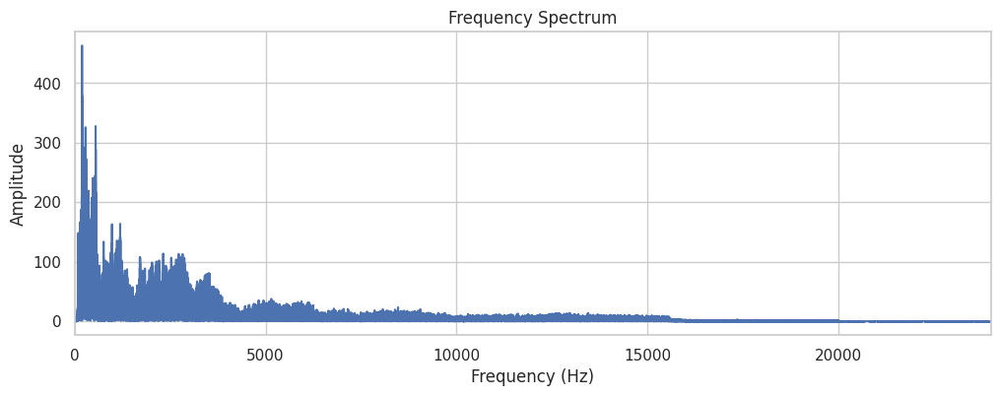

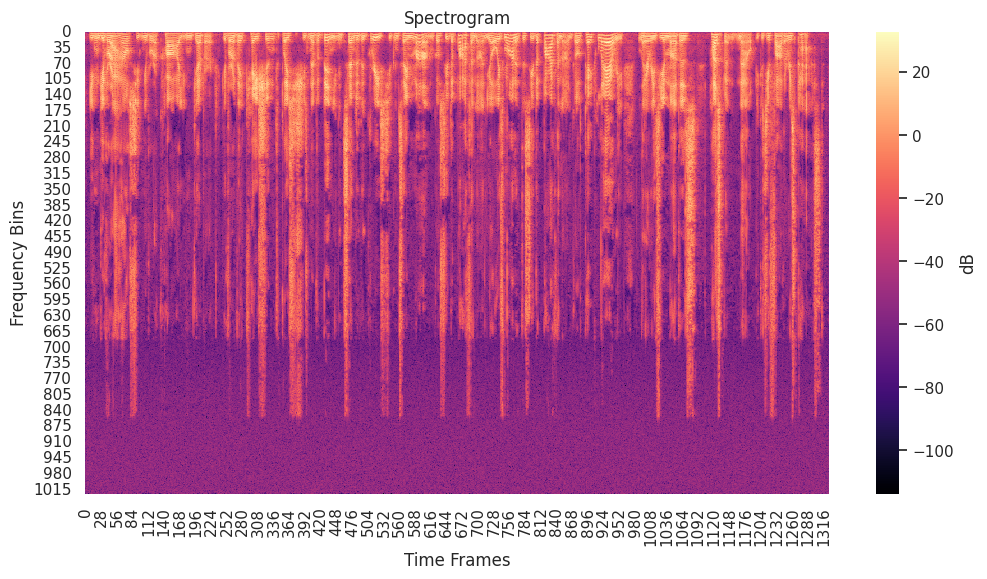

In [82]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Optional: nicer Seaborn style
sns.set(style="whitegrid")

# Load audio
audio_path = "justin-master-class.wav"
y, sr = librosa.load(audio_path, sr=None)

# -----------------------------
# 1️⃣ Frequency Spectrum
# -----------------------------
fft = np.fft.fft(y)
fft_magnitude = np.abs(fft)[:len(fft)//2]
freqs = np.fft.fftfreq(len(fft), 1/sr)[:len(fft)//2]

plt.figure(figsize=(12, 4))
plt.plot(freqs, fft_magnitude)
plt.title("Frequency Spectrum")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Amplitude")
plt.xlim(0, sr//2)
plt.show()

# -----------------------------
# 2️⃣ Spectrogram (STFT)
# -----------------------------
D = np.abs(librosa.stft(y))
DB = 20 * np.log10(D + 1e-6)  # convert amplitude to dB

plt.figure(figsize=(12, 6))
sns.heatmap(DB, cmap="magma", cbar_kws={'label': 'dB'})
plt.title("Spectrogram")
plt.xlabel("Time Frames")
plt.ylabel("Frequency Bins")
plt.show()


In [83]:
from transformers import MimiModel


model = MimiModel.from_pretrained("kyutai/mimi")

with torch.no_grad():
    tokens = model.encode(input_audio[None, None, :]).audio_codes

In [84]:
tokens = tokens.flip(-2)

In [85]:
tokens[0,1,0]

tensor(1477)

In [86]:
timestep=0
layer=0


model.quantizer.acoustic_residual_vector_quantizer.layers[layer].codebook.embed[tokens[0,layer+1,timestep]]


tensor([ 6.6382e-02,  4.3759e-01,  1.3163e-01,  9.7953e-02, -8.7689e-03,
         8.2679e-02, -1.4715e-01,  1.6432e-01, -1.4698e-01,  3.3681e-01,
         3.1514e-01, -1.0359e-01,  8.0037e-02, -1.5838e-01,  5.1630e-02,
        -3.1429e-02, -7.5689e-02, -1.4251e-01, -5.6052e-01, -5.6631e-02,
        -8.7544e-02,  1.0587e-01,  1.6329e-01, -3.4863e-02,  9.1855e-02,
         2.3618e-01,  2.6716e-01,  2.3251e-01,  5.4048e-02, -9.2622e-02,
         3.0644e-01,  4.8536e-02, -3.5842e-02,  1.1682e-01,  1.3912e-01,
         2.1168e-01,  7.8212e-02, -4.8251e-02,  3.0047e-03,  2.5864e-02,
        -1.1171e-01,  8.5177e-02, -1.1168e-01,  3.0583e-02,  1.3864e-01,
         6.6888e-02, -3.0343e-02, -1.8381e-01, -1.7969e-01,  3.3826e-01,
         4.5036e-02,  1.6731e-02,  2.8532e-01, -5.1298e-02, -1.4679e-01,
         1.1251e-01,  1.8196e-01,  2.1700e-01, -1.5425e-01, -2.1041e-02,
        -4.2937e-01,  1.0153e-01, -1.5794e-01, -1.0546e-01,  9.3509e-02,
         2.0728e-01,  2.0522e-01, -1.4221e-01,  1.6

In [87]:
import torch

batch_size, n_layers_plus1, n_timesteps = tokens.shape
n_layers = n_layers_plus1 - 1  # assuming tokens includes input layer

# Prepare list to store summed embeddings per layer
layer_sums = []

for layer in range(n_layers):
    # Get the embeddings for all timesteps in this layer
    # Shape: (batch_size, n_timesteps, embedding_dim)
    embeds = model.quantizer.acoustic_residual_vector_quantizer.layers[layer].codebook.embed[
        tokens[:, layer+1, :]  # select tokens for this layer across timesteps
    ]  # embeds shape: (batch_size, n_timesteps, embedding_dim)

    # Sum across the time dimension
    sum_over_time = embeds.sum(dim=1)  # shape: (batch_size, embedding_dim)
    layer_sums.append(sum_over_time)

# Now layer_sums[layer] contains the sum of embeddings across time for that layer

# Stack list of per-layer sums into one tensor: shape (n_layers, batch_size, embedding_dim)
layer_sums_tensor = torch.stack(layer_sums, dim=0)

# Now sum across layers to get one vector per sample
manual_sum = layer_sums_tensor.sum(dim=0)  # shape: (batch_size, embedding_dim)

# Decode tokens
decoded_embeddings = model.quantizer.decode(tokens)  # shape: (batch_size, decoded_dim)

print("Manual sum shape:", manual_sum.shape)
print("Decoded embeddings shape:", decoded_embeddings.shape)

Manual sum shape: torch.Size([1, 256])
Decoded embeddings shape: torch.Size([1, 512, 177])


In [88]:
# Sum across layers to get a single vector per sample
manual_sum = layer_sums_tensor.sum(dim=0)  # shape: (batch_size, embedding_dim)

decoded_embeddings = model.quantizer.decode(tokens)  # shape: (batch_size, decoded_dim)

print("Manual sum shape:", manual_sum.shape)
print("Decoded embeddings shape:", decoded_embeddings.shape)

# Compare mean and standard deviation per sample
manual_mean = manual_sum.mean(dim=1)
manual_std  = manual_sum.std(dim=1)
decoded_mean = decoded_embeddings.mean(dim=1)
decoded_std  = decoded_embeddings.std(dim=1)

print("Mean difference:", (decoded_mean - manual_mean).mean().item())
print("SD difference:", (decoded_std - manual_std).mean().item())


Manual sum shape: torch.Size([1, 256])
Decoded embeddings shape: torch.Size([1, 512, 177])
Mean difference: 0.07094614207744598
SD difference: 0.9478281140327454


NumPy shapes: (2048,) (3, 256)
Torch shapes: torch.Size([2048]) torch.Size([3, 256])
Number of iterations run: 28


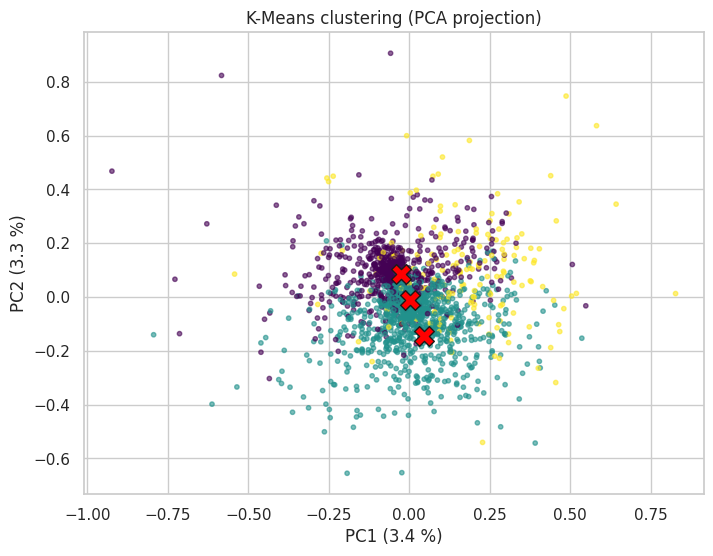

In [89]:
import torch
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Your tensor (2048, 256)
data = model.quantizer.acoustic_residual_vector_quantizer.layers[2].codebook.embed
data_np = data.cpu().numpy()

# Run k-means
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(data_np)

# NumPy (default from sklearn)
labels_np = kmeans.labels_
centroids_np = kmeans.cluster_centers_

# Torch (convert for later PyTorch use)
labels_torch = torch.from_numpy(labels_np)              # keeps dtype=int64
centroids_torch = torch.from_numpy(centroids_np)        # keeps dtype=float64

print("NumPy shapes:", labels_np.shape, centroids_np.shape)
print("Torch shapes:", labels_torch.shape, centroids_torch.shape)
print("Number of iterations run:", kmeans.n_iter_)



###Plotting###
# Reduce dimensions to 2D for visualization
pca = PCA(n_components=2)
data_2d = pca.fit_transform(data_np)
centroids_2d = pca.transform(centroids)
explained_var = pca.explained_variance_ratio_ * 100

# Plot
plt.figure(figsize=(8,6))
plt.scatter(data_2d[:,0], data_2d[:,1], c=labels, cmap="viridis", s=10, alpha=0.6)
plt.scatter(centroids_2d[:,0], centroids_2d[:,1], c="red", marker="X", s=200, edgecolors="k")

plt.title("K-Means clustering (PCA projection)")
plt.xlabel(f"PC1 ({explained_var[0]:.1f} %)")
plt.ylabel(f"PC2 ({explained_var[1]:.1f} %)")
plt.show()

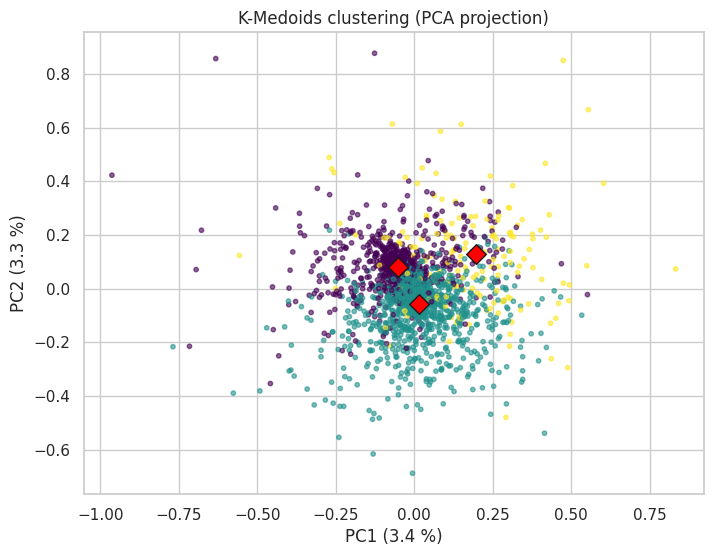

In [90]:
import torch
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn_extra.cluster import KMedoids  # pip install scikit-learn-extra

# Your data (2048, 256)
data = model.quantizer.acoustic_residual_vector_quantizer.layers[2].codebook.embed
data_np = data.cpu().numpy()

# --- PCA to 2 components ---
pca = PCA(n_components=2)
data_2d = pca.fit_transform(data_np)
explained_var = pca.explained_variance_ratio_ * 100  # percentage

# --- Run k-medoids (example: 3 clusters) ---
kmedoids = KMedoids(n_clusters=3, random_state=42, method="pam")  # or "alternate"
kmedoids.fit(data_np)
labels = kmedoids.labels_

# Project medoids into PCA space
medoids_2d = pca.transform(kmedoids.cluster_centers_)

# --- Plot ---
plt.figure(figsize=(8,6))
plt.scatter(data_2d[:,0], data_2d[:,1], c=labels, cmap="viridis", s=10, alpha=0.6)
plt.scatter(medoids_2d[:,0], medoids_2d[:,1], c="red", marker="D", s=100, edgecolors="k")  # diamonds for medoids

plt.title("K-Medoids clustering (PCA projection)")
plt.xlabel(f"PC1 ({explained_var[0]:.1f} %)")
plt.ylabel(f"PC2 ({explained_var[1]:.1f} %)")
plt.show()


In [100]:
with torch.no_grad():
    #to be replaced
    embeddings = model.quantizer.decode(tokens)
    
    
    
    # Do weird things here
    #bias = torch.randn(1, embeddings.shape[1], 1) * 0.3
    #embeddings += bias

    # noise = torch.randn(1, embeddings.shape[1], embeddings.shape[2]) * 3
    # embeddings += noise

    #embeddings *= -1

    decoder_outputs = model.decoder_transformer(
        model.upsample(embeddings).transpose(1, 2), return_dict=False
    )
    embeddings = decoder_outputs[0].transpose(1, 2)
    audio_values = model.decoder(embeddings)

In [101]:
import numpy as np
from IPython.display import Audio

Audio(audio_values.numpy()[0], rate=target_sample_rate)

Plotting 2

In [102]:
# Option 1: squeeze all singleton dimensions
audio_np = audio_values.squeeze().cpu().numpy()
print("audio_np shape:", audio_np.shape)  # (339840,)

# Option 2: explicitly index batch and channel
audio_np = audio_values[0, 0].cpu().numpy()
print("audio_np shape:", audio_np.shape)  # (339840,)


audio_np shape: (339840,)
audio_np shape: (339840,)


In [103]:
print("audio_values shape:", audio_values.shape)
print("min/max:", audio_values.min().item(), audio_values.max().item())


audio_np = audio_values.cpu().numpy()[0]  # for shape (1, sequence_length)
print("audio_np shape:", audio_np.shape)
print("min/max:", audio_np.min(), audio_np.max())

fft = np.fft.fft(audio_np)
fft_magnitude = np.abs(fft)[:len(fft)//2]
print("FFT length:", len(fft_magnitude))

D = np.abs(librosa.stft(audio_np))
DB = 20 * np.log10(D + 1e-6)
print("Spectrogram shape:", DB.shape)

audio_values shape: torch.Size([1, 1, 339840])
min/max: -0.9138416051864624 0.8274850845336914
audio_np shape: (1, 339840)
min/max: -0.9138416 0.8274851
FFT length: 0
Spectrogram shape: (1, 1025, 664)


In [104]:
import numpy as np
import plotly.graph_objects as go
import librosa

# Time-domain waveform
time = np.arange(audio_np.shape[0]) / target_sample_rate
fig_wave = go.Figure()
fig_wave.add_trace(go.Scatter(x=time, y=audio_np, mode='lines'))
fig_wave.update_layout(title="Generated Audio Waveform",
                       xaxis_title="Time (s)",
                       yaxis_title="Amplitude")
fig_wave.show(renderer="notebook")

# FFT spectrum
fft = np.fft.fft(audio_np)
fft_magnitude = np.abs(fft)[:len(fft)//2]
freqs = np.fft.fftfreq(len(fft), 1/target_sample_rate)[:len(fft)//2]

fig_fft = go.Figure()
fig_fft.add_trace(go.Scatter(x=freqs, y=fft_magnitude, mode='lines'))
fig_fft.update_layout(title="Generated Audio Frequency Spectrum",
                      xaxis_title="Frequency (Hz)",
                      yaxis_title="Amplitude")
fig_fft.show(renderer="notebook")

# Spectrogram
D = np.abs(librosa.stft(audio_np))
DB = 20 * np.log10(D + 1e-6)
time_spec = np.arange(DB.shape[1]) * (len(audio_np)/target_sample_rate) / DB.shape[1]
freqs_spec = np.linspace(0, target_sample_rate/2, DB.shape[0])

fig_spec = go.Figure(data=go.Heatmap(
    z=DB,
    x=time_spec,
    y=freqs_spec,
    colorscale='Magma'
))
fig_spec.update_layout(title="Generated Audio Spectrogram",
                       xaxis_title="Time (s)",
                       yaxis_title="Frequency (Hz)")
fig_spec.show(renderer="notebook")


TEST2

In [105]:
#input_audio, orig_sample_rate = librosa.load("justin-master-class.wav")
#input_audio = librosa.resample(
    #input_audio, orig_sr=orig_sample_rate, target_sr=target_sample_rate
#)
input_audio2 = torch.Tensor(audio_values.numpy()[0])

In [106]:
input_audio2.shape

torch.Size([1, 339840])

In [107]:
# Load audio
audio_path = "justin-master-class.wav"
input_audio2, sr = librosa.load(audio_path, sr=24000)  # model expects 24kHz

# Convert to float32 tensor
audio_tensor2 = torch.tensor(input_audio2, dtype=torch.float32)

# Reshape to (batch_size=1, channels=1, sequence_length)
audio_tensor2 = audio_tensor.unsqueeze(0).unsqueeze(0)

# Pass to model
with torch.no_grad():
    tokens = model.encode(audio_tensor2).audio_codes

NameError: name 'audio_tensor' is not defined

In [108]:
#tokens = tokens.flip(2)

In [109]:
with torch.no_grad():
    embeddings = model.quantizer.decode(tokens)

    # Do weird things here
    # bias = torch.randn(1, embeddings.shape[1], 1) * 3
    # embeddings += bias

    # noise = torch.randn(1, embeddings.shape[1], embeddings.shape[2]) * 3
    # embeddings += noise

    embeddings *= +2

    decoder_outputs = model.decoder_transformer(
        model.upsample(embeddings).transpose(1, 2), return_dict=False
    )
    embeddings = decoder_outputs[0].transpose(1, 2)
    audio_values = model.decoder(embeddings)

In [110]:
import numpy as np
from IPython.display import Audio

Audio(audio_values.numpy()[0], rate=target_sample_rate)